<a href="https://colab.research.google.com/github/Rohith1165/Infant-Monitoring-Systems/blob/main/Infant_project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import pandas as pd
import plotly.graph_objs as go
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

In [2]:
# Reading the file
df=pd.read_csv("PA10 HV_waist.csv")

In [3]:
#let's correct the column names by stripping leading spaces
df.columns = [col.strip() for col in df.columns]

In [4]:
# Now we will convert the 'Date' and 'Time' columns into a single datetime column
df['Datetime'] = pd.to_datetime(df['Date'] + ' ' + df['Time'], dayfirst=True)

In [5]:
# Set 'Datetime' as the index of the dataframe
df.set_index('Datetime', inplace=True)

# Droping the 'Date' and 'Time' columns
df.drop(['Date', 'Time'], axis=1, inplace=True)

In [6]:
df.head()

,Axis 1,Axis 2,Axis 3,Steps,Lux,Inclinometer Off,Inclinometer Standing,Inclinometer Sitting,Inclinometer Lying,Vector Magnitude
Datetime,,,,,,,,,,
2021-11-18 00:00:00,0,0,0,0,0,1,0,0,0,0.0
2021-11-18 00:00:01,0,0,0,0,0,1,0,0,0,0.0
2021-11-18 00:00:02,0,0,0,0,0,1,0,0,0,0.0
2021-11-18 00:00:03,0,0,0,0,0,1,0,0,0,0.0
2021-11-18 00:00:04,0,0,0,0,0,1,0,0,0,0.0


In [7]:
df.tail()

,Axis 1,Axis 2,Axis 3,Steps,Lux,Inclinometer Off,Inclinometer Standing,Inclinometer Sitting,Inclinometer Lying,Vector Magnitude
Datetime,,,,,,,,,,
2021-11-21 18:59:55,0,0,4,0,0,0,0,1,0,4.00
2021-11-21 18:59:56,0,0,1,0,0,0,0,1,0,1.00
2021-11-21 18:59:57,0,0,7,0,0,0,0,1,0,7.00
2021-11-21 18:59:58,0,0,0,0,0,0,0,1,0,0.00
2021-11-21 18:59:59,13,61,10,1,0,0,1,0,0,63.17


In [8]:
df.index[0]

Timestamp('2021-11-18 00:00:00')

In [9]:
start_time='2021-11-18 00:00:00'
end_time='2021-11-18 23:59:00'
df_sleeping = df[start_time:end_time]

In [10]:
df_sleeping.head()

,Axis 1,Axis 2,Axis 3,Steps,Lux,Inclinometer Off,Inclinometer Standing,Inclinometer Sitting,Inclinometer Lying,Vector Magnitude
Datetime,,,,,,,,,,
2021-11-18 00:00:00,0,0,0,0,0,1,0,0,0,0.0
2021-11-18 00:00:01,0,0,0,0,0,1,0,0,0,0.0
2021-11-18 00:00:02,0,0,0,0,0,1,0,0,0,0.0
2021-11-18 00:00:03,0,0,0,0,0,1,0,0,0,0.0
2021-11-18 00:00:04,0,0,0,0,0,1,0,0,0,0.0


In [11]:
df_sleeping.tail()

,Axis 1,Axis 2,Axis 3,Steps,Lux,Inclinometer Off,Inclinometer Standing,Inclinometer Sitting,Inclinometer Lying,Vector Magnitude
Datetime,,,,,,,,,,
2021-11-18 23:58:56,0,0,0,0,0,1,0,0,0,0.0
2021-11-18 23:58:57,0,0,0,0,0,1,0,0,0,0.0
2021-11-18 23:58:58,0,0,0,0,0,1,0,0,0,0.0
2021-11-18 23:58:59,0,0,0,0,0,1,0,0,0,0.0
2021-11-18 23:59:00,0,0,0,0,0,1,0,0,0,0.0


In [12]:
x=go.Scatter(x=df.index, y=df_sleeping['Axis 1'], mode='lines', name='X-axis')
y=go.Scatter(x=df.index, y=df_sleeping['Axis 2'], mode='lines', name='y-axis')
z=go.Scatter(x=df.index, y=df_sleeping['Axis 3'], mode='lines', name='z-axis')
vm=go.Scatter(x=df.index, y=df_sleeping['Vector Magnitude'], mode='lines', name='Vector Magnitude')

layout=go.Layout(title='Vector Magnitude', xaxis=dict(title='Time'), yaxis=dict(title='Accelerometer data'))

fig=go.Figure(data=[x,y,z,vm], layout=layout)

fig.show()

In [13]:
# # Initialize variables for tracking
# in_zero_sequence = False
# start_time = None
# zero_periods = []

# # Iterate through the DataFrame
# for idx, row in df_sleeping.iterrows():
#     vector_magnitude = row['Vector Magnitude']

#     # Check if current value is zero and we're not already in a sequence
#     if vector_magnitude == 0 and not in_zero_sequence:
#         # Start tracking a new sequence
#         in_zero_sequence = True
#         start_time = idx  # Mark the start time of this sequence

#     # If current value is not zero and we are in a sequence
#     elif vector_magnitude != 0 and in_zero_sequence:
#         # End of the current sequence
#         end_time = idx
#         duration = end_time - start_time

#         # Optionally filter very short sequences, e.g., less than 5 minutes
#         if duration >= pd.Timedelta(minutes=5):
#             zero_periods.append((start_time, end_time, duration))

#         # Reset tracking variables
#         in_zero_sequence = False
#         start_time = None

# # Check if the last row of the DataFrame ends a zero sequence
# if in_zero_sequence:
#     end_time = df_sleeping.index[-1]
#     duration = end_time - start_time
#     if duration >= pd.Timedelta(minutes=5):
#         zero_periods.append((start_time, end_time, duration))

# # Print or process the zero periods
# for start, end, duration in zero_periods:
#     print(f"Sleeping period from {start} to {end}, Duration: {duration}")

# total_zero_duration = sum([period[2] for period in zero_periods], pd.Timedelta(0))

# # Print the total duration in a more readable format
# print(f"Total Duration of Sleeping Periods: {total_zero_duration}")
# print("Count of Sleeping periods:",len(zero_periods))

In [64]:
import pandas as pd

# Initialize variables for tracking
in_zero_sequence = False
start_time = None
zero_periods = []
merge_threshold = pd.Timedelta(minutes=1)  # Threshold for merging closely consecutive periods

# Helper function to add or merge periods
def add_or_merge_period(start_time, end_time, duration):
    if zero_periods:
        last_start, last_end, last_duration = zero_periods[-1]
        # If the start time of the current period is within the merge threshold of the last period's end time
        if start_time - last_end <= merge_threshold:
            # Merge the current period with the last by extending the last period's end time and duration
            new_duration = last_duration + (end_time - last_end)
            zero_periods[-1] = (last_start, end_time, new_duration)
        else:
            # Add the current period as a new entry
            zero_periods.append((start_time, end_time, duration))
    else:
        # If this is the first period, just add it
        zero_periods.append((start_time, end_time, duration))

# Iterate through the DataFrame
for idx, row in df_sleeping.iterrows():
    vector_magnitude = row['Vector Magnitude']

    # Check if current value is zero and we're not already in a sequence
    if vector_magnitude == 0 and not in_zero_sequence:
        # Start tracking a new sequence
        in_zero_sequence = True
        start_time = idx  # Mark the start time of this sequence

    # If current value is not zero and we are in a sequence
    elif vector_magnitude != 0 and in_zero_sequence:
        # End of the current sequence
        end_time = idx
        duration = end_time - start_time

        # Optionally filter very short sequences, e.g., less than 5 minutes
        if duration >= pd.Timedelta(minutes=5):
            add_or_merge_period(start_time, end_time, duration)

        # Reset tracking variables
        in_zero_sequence = False
        start_time = None

# Check if the last row of the DataFrame ends a zero sequence
if in_zero_sequence:
    end_time = df_sleeping.index[-1]
    duration = end_time - start_time
    if duration >= pd.Timedelta(minutes=5):
        add_or_merge_period(start_time, end_time, duration)

# Print or process the zero periods
for start, end, duration in zero_periods:
    print(f"Sleeping period from {start} to {end}, Duration: {duration}")

total_zero_duration = sum([period[2] for period in zero_periods], pd.Timedelta(0))

# Print the total duration in a more readable format
print(f"Total Duration of Sleeping Periods: {total_zero_duration}")
print("Count of Sleeping periods:", len(zero_periods))

Sleeping period from 2021-11-18 00:00:00 to 2021-11-18 07:00:31, Duration: 0 days 07:00:31
Sleeping period from 2021-11-18 07:02:31 to 2021-11-18 07:25:07, Duration: 0 days 00:22:36
Sleeping period from 2021-11-18 07:45:01 to 2021-11-18 07:52:12, Duration: 0 days 00:07:11
Sleeping period from 2021-11-18 08:12:31 to 2021-11-18 08:22:06, Duration: 0 days 00:09:35
Sleeping period from 2021-11-18 08:23:18 to 2021-11-18 08:33:07, Duration: 0 days 00:09:49
Sleeping period from 2021-11-18 12:08:40 to 2021-11-18 13:16:50, Duration: 0 days 01:08:10
Sleeping period from 2021-11-18 13:27:17 to 2021-11-18 13:36:29, Duration: 0 days 00:09:12
Sleeping period from 2021-11-18 13:37:55 to 2021-11-18 13:46:18, Duration: 0 days 00:08:23
Sleeping period from 2021-11-18 19:07:31 to 2021-11-18 23:59:00, Duration: 0 days 04:51:29
Total Duration of Sleeping Periods: 0 days 14:06:56
Count of Sleeping periods: 9


In [65]:
zero_periods
df_zero_periods=[zero_periods]

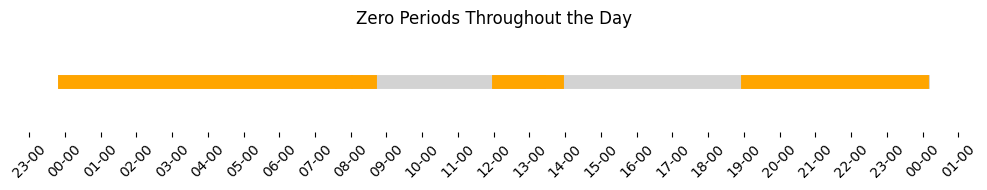

In [25]:
# Create a figure and subplot with a specific size
fig, ax = plt.subplots(figsize=(10, 2))

# Plot the whole day's background
day_start = df_sleeping.index.min().replace(hour=0, minute=0, second=0, microsecond=0)
day_end = day_start + pd.Timedelta(days=1)
ax.plot([day_start, day_end], [1, 1], label='Daytime', color='lightgrey', linewidth=10)

# Plot each zero period on top of the day's background
for start, end, _ in zero_periods:
    ax.plot([start, end], [1, 1], label='Zero Period', color='orange', linewidth=10)

# Improve the look & feel of the plot
ax.set_ylim(0.5, 1.5)  # Adjust y-limits to better fit the single line
ax.yaxis.set_visible(False)  # Hide the y-axis as it's not meaningful here
ax.spines[['left', 'right', 'top', 'bottom']].set_visible(False)  # Hide the box around the plot

# Format the x-axis to show hours and optionally days if the dataset spans multiple days
ax.xaxis.set_major_locator(mdates.HourLocator(interval=1))
ax.xaxis.set_minor_locator(mdates.HourLocator(interval=1))
ax.xaxis.set_major_formatter(mdates.DateFormatter('%H-%M'))

plt.xticks(rotation=45)
plt.title('Zero Periods Throughout the Day')
plt.tight_layout()  # Adjust the layout to make room for the rotated x-axis labels

# Show the plot
plt.show()


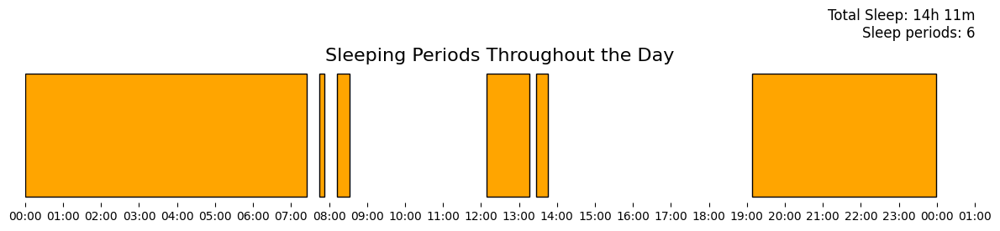

In [28]:
total_duration = sum((end - start for start, end, _ in zero_periods), pd.Timedelta(0))
# Calculate total hours and minutes for display
total_hours = total_duration.components.hours
total_minutes = total_duration.components.minutes

# Create figure and subplot with a larger vertical size for clarity
fig, ax = plt.subplots(figsize=(12, 3))

# Set background color for day and night
# ax.axhspan(0, 1, color='lightgrey', alpha=0.3, zorder=0)  # Background for the whole day

# Add bars for each zero period
for start, end, _ in zero_periods:  # The underscore ignores the duration part
    ax.barh(0, end-start, left=start, height=1, color='orange', edgecolor='black', zorder=3)

# Add text for the total sleep time
ax.text(1, 1.2, f'Total Sleep: {total_hours}h {total_minutes}m\nSleep periods: {len(zero_periods)}',
        horizontalalignment='right', verticalalignment='bottom',
        transform=ax.transAxes, fontsize=12, color='black')

# Remove y-axis and spines since they are not needed
ax.yaxis.set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['bottom'].set_visible(False)



# Set the x-axis format to show the time of day for every hour
ax.xaxis_date()
ax.xaxis.set_major_locator(mdates.HourLocator(interval=1))  # Set major ticks to every hour
ax.xaxis.set_minor_locator(mdates.MinuteLocator(interval=60))  # Ensures that ticks are set properly for hours
ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M'))  # Set formatter to show hours and minutes

# Ensure the x-axis covers the full 24 hours from 00:00 to 24:00
from datetime import timedelta
ax.set_xlim(day_start, day_end + timedelta(hours=1)) #

# Set the x-axis format to show the time
ax.xaxis_date()
ax.xaxis.set_major_locator(mdates.HourLocator(interval=1))
ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M'))
plt.xticks()

# Set title and adjust layout
plt.title('Sleeping Periods Throughout the Day', fontsize=16)
plt.tight_layout()

# Show the plot
plt.show()

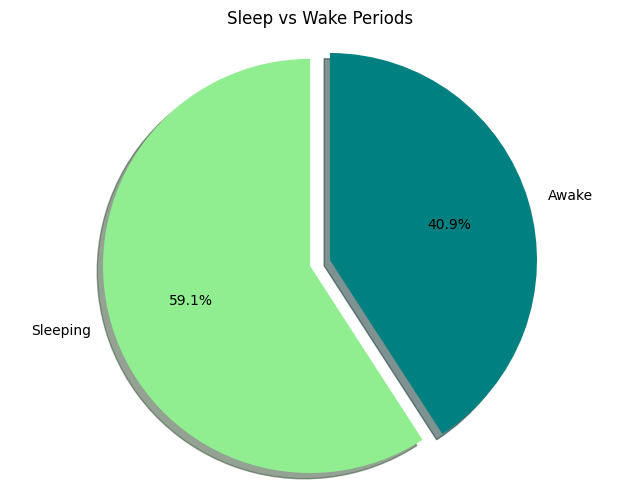

In [18]:

# Assuming total_zero_duration is the total duration of sleeping periods you've calculated
# Calculate the total duration covered by your dataset
total_duration = df_sleeping.index[-1] - df_sleeping.index[0] + pd.Timedelta(minutes=1)  # Adding 1 minute to include the last minute

# Calculate total wake duration
total_wake_duration = total_duration - total_zero_duration

# Prepare data for the pie chart
labels = 'Sleeping', 'Awake'
sizes = [total_zero_duration.total_seconds(), total_wake_duration.total_seconds()]
colors = ['lightgreen', 'teal']
explode = (0, 0.1)  # only "explode" the 2nd slice (i.e., 'Awake')

# Plot
plt.figure(figsize=(8, 6))
plt.pie(sizes, explode=explode, labels=labels, colors=colors, autopct='%1.1f%%',
        shadow=True, startangle=90)
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.title('Sleep vs Wake Periods')
plt.show()


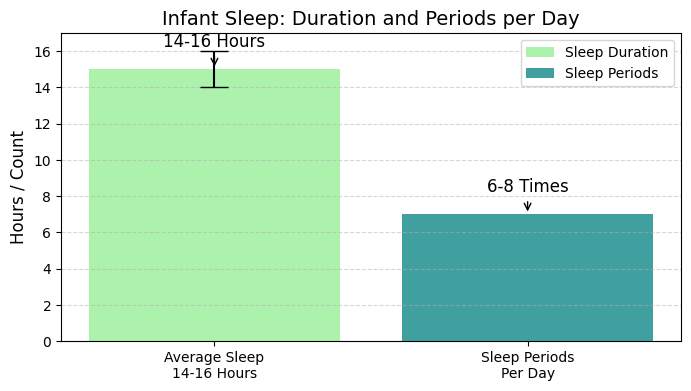

In [19]:
# Adjusting the visualization for the corrected count of sleep periods per day (6-8 times)

# Updated data for plotting
categories = ['Average Sleep\n14-16 Hours', 'Sleep Periods\nPer Day']
hours = [15, 7]  # Using the midpoint as the representative value for sleep and updating the average for sleep periods to 7 (6-8)
error = [[1], [1]]  # Reflecting the range as error bars extending 1 hour in both directions for sleep and 1 for periods

fig, ax = plt.subplots(figsize=(8, 4))

# Creating the bar chart with enhanced appearance
bars = ax.bar(categories[0], hours[0], yerr=error[0], capsize=10, color='lightgreen', ecolor='black', alpha=0.75, label='Sleep Duration')
ax.bar(categories[1], hours[1], capsize=10, color='teal', ecolor='black', alpha=0.75, label='Sleep Periods')

# Adding some labels, title, and customizing the axes for better readability
ax.set_ylabel('Hours / Count', fontsize=12)
ax.set_title('Infant Sleep: Duration and Periods per Day', fontsize=14)
ax.set_ylim(0, 17)  # Adjust y-axis to accommodate both metrics

# Annotating the average range and periods directly on the plot for clarity
ax.annotate('14-16 Hours',
            xy=(0, 15), xycoords='data',
            xytext=(0, 16), textcoords='data',
            arrowprops=dict(arrowstyle="->", connectionstyle="arc3"),
            ha='center', va='bottom', fontsize=12, color='black')

ax.annotate('6-8 Times',
            xy=(1, 7), xycoords='data',
            xytext=(1, 8), textcoords='data',
            arrowprops=dict(arrowstyle="->", connectionstyle="arc3"),
            ha='center', va='bottom', fontsize=12, color='black')

plt.grid(axis='y', linestyle='--', alpha=0.5)

# Adding a legend to differentiate between sleep duration and periods
plt.legend()

plt.show()


In [68]:
df_zero_periods = pd.DataFrame(zero_periods, columns=['Start', 'End', 'Duration'])
df_zero_periods['Start'] = pd.to_datetime(df_zero_periods['Start'])
df_zero_periods['End'] = pd.to_datetime(df_zero_periods['End'])

# Assuming waking up is the end of the first zero period that starts before noon
waking_up_time = df_zero_periods[df_zero_periods['End'].dt.hour < 12].iloc[0]['End']

# Assuming sleeping is the start of the first zero period that starts after or at 6 PM
sleeping_time = df_zero_periods[df_zero_periods['Start'].dt.hour >= 18].iloc[0]['Start']

print(f"The baby first wakes up in the morning at: {waking_up_time}")
print(f"The baby starts sleeping in the evening at: {sleeping_time}")


The baby first wakes up in the morning at: 2021-11-18 07:00:31
The baby starts sleeping in the evening at: 2021-11-18 19:07:31


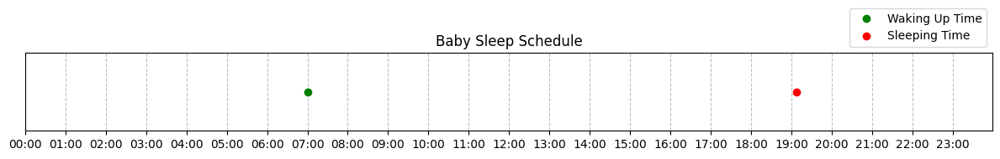

In [69]:

# Create a figure and a subplot
fig, ax = plt.subplots(figsize=(12, 2))

# Set the range for the x-axis to cover the full day
ax.set_xlim(pd.Timestamp('2021-11-18 00:00'), pd.Timestamp('2021-11-18 23:59'))

# Add markers for waking up and sleeping times
ax.plot(waking_up_time, 1, 'go', label='Waking Up Time')  # 'go' for green circle
ax.plot(sleeping_time, 1, 'ro', label='Sleeping Time')  # 'ro' for red circle

# # Annotate the waking up and sleeping times
# ax.annotate('Wakes Up', (waking_up_time, 1), textcoords="offset points", xytext=(-35,-10), ha='center', color='green')
# ax.annotate('Sleeps', (sleeping_time, 1), textcoords="offset points", xytext=(35,-10), ha='center', color='red')

# Customize the x-axis to show hours
ax.xaxis.set_major_locator(mdates.HourLocator())
ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M'))
plt.xticks()

# Add grid for better readability
ax.grid(True, which='major', linestyle='--', color='gray', alpha=0.5)

# Remove y-axis as it's not meaningful for this plot
ax.yaxis.set_visible(False)

# Set plot title and show legend
plt.title('Baby Sleep Schedule')
plt.legend(loc="lower right",bbox_to_anchor=(1, 1))

# Show the plot
plt.tight_layout()
plt.show()


In [70]:
df_zero_periods['Duration'] = pd.to_timedelta(df_zero_periods['Duration'])

# Find the longest sleep period
longest_sleep_period = df_zero_periods.loc[df_zero_periods['Duration'].idxmax()]
smallest_sleep_period = df_zero_periods.loc[df_zero_periods['Duration'].idxmin()]

print("The longest sleep period is:")
print(f"Start: {longest_sleep_period['Start']}, End: {longest_sleep_period['End']}, Duration: {longest_sleep_period['Duration']}")
print("The smallest sleep period is:")
print(f"Start: {smallest_sleep_period['Start']}, End: {smallest_sleep_period['End']}, Duration: {smallest_sleep_period['Duration']}")


The longest sleep period is:
Start: 2021-11-18 00:00:00, End: 2021-11-18 07:00:31, Duration: 0 days 07:00:31
The smallest sleep period is:
Start: 2021-11-18 07:45:01, End: 2021-11-18 07:52:12, Duration: 0 days 00:07:11


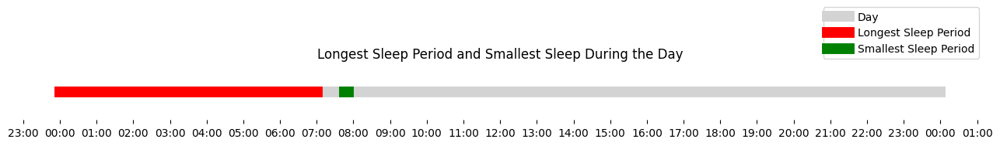

In [71]:
# Create the plot
fig, ax = plt.subplots(figsize=(13, 2))  # Adjust the size as needed

# Plot a line for the entire day for context
day_start = df_zero_periods['Start'].min().normalize()  # This sets the time to 00:00:00
day_end = day_start + pd.Timedelta(days=1)
ax.plot([day_start, day_end], [1, 1], label='Day', color='lightgrey', linewidth=10)

# Highlight the longest sleep period
ax.plot([longest_sleep_period['Start'], longest_sleep_period['End']], [1, 1], label='Longest Sleep Period', color='red', linewidth=10)
ax.plot([smallest_sleep_period['Start'], smallest_sleep_period['End']], [1, 1], label='Smallest Sleep Period', color='green', linewidth=10)

# Improve the aesthetics of the plot
ax.set_ylim(0.5, 1.5)
ax.yaxis.set_visible(False)  # The y-axis is not meaningful here
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)

# Format the x-axis to display time
ax.xaxis_date()  # Tell matplotlib that x-axis is dates
ax.xaxis.set_major_locator(mdates.HourLocator(interval=1))
ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M'))

# Rotate date labels for better readability
plt.xticks()

# Add a legend to explain the plot
plt.legend(loc="lower right",bbox_to_anchor=(1, 1))

# Set title
plt.title('Longest Sleep Period and Smallest Sleep During the Day')


# Display the plot
plt.tight_layout()  # Adjust the layout to make room for the rotated x-axis labels
plt.show()